In [14]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from math import sqrt

# 读入

In [15]:
Bus_Stops = pd.read_csv('data\Bus_Stops.csv')
edges_all = pd.read_csv('data\edges_all.csv')
nodes_all = pd.read_csv('data/nodes_all.csv')

<>:1: SyntaxWarning: invalid escape sequence '\B'
<>:2: SyntaxWarning: invalid escape sequence '\e'
<>:1: SyntaxWarning: invalid escape sequence '\B'
<>:2: SyntaxWarning: invalid escape sequence '\e'
C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1748265012.py:1: SyntaxWarning: invalid escape sequence '\B'
  Bus_Stops = pd.read_csv('data\Bus_Stops.csv')
C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1748265012.py:2: SyntaxWarning: invalid escape sequence '\e'
  edges_all = pd.read_csv('data\edges_all.csv')
C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1748265012.py:2: DtypeWarning: Columns (15,19) have mixed types. Specify dtype option on import or set low_memory=False.
  edges_all = pd.read_csv('data\edges_all.csv')
C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1748265012.py:3: DtypeWarning: Columns (6) have mixed types. Specify dtype option on import or set low_memory=False.
  nodes_all = pd.read_csv('data/nodes_all.csv')


# 转换

In [16]:
Bus_Stops['Routes_Ser'] = Bus_Stops['Routes_Ser'].apply(lambda row: len(row.split(',')) if isinstance(row, str) else 0)


In [17]:
Bus_Stops['Routes_Ser'] = Bus_Stops['Routes_Ser'].apply(lambda row: len(row.split(',')) if isinstance(row, str) else 0)
edges_all["lanes"] = pd.to_numeric(edges_all["lanes"], errors="coerce")
edges_all["maxspeed"] = edges_all["maxspeed"].apply(
    lambda x: x.replace("mph", "").strip() if isinstance(x, str) else x
)
# 如果 'maxspeed' 列包含像 ['45 ', '60 '] 这样的列表，取出第一个值
edges_all["maxspeed"] = edges_all["maxspeed"].apply(
    lambda x: eval(x)[0] if isinstance(x, str) and x.startswith("[") else x
)
edges_all["maxspeed"] = pd.to_numeric(edges_all["maxspeed"], errors="coerce")
edges_all["lanes"].fillna(edges_all["lanes"].median(), inplace=True)
edges_all["maxspeed"].fillna(edges_all["maxspeed"].median(), inplace=True)

pos=dict()
for _,row in nodes_all.iterrows():
    pos[row['osmid']]=(row['x'],row['y'])

C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1801522482.py:11: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  edges_all["lanes"].fillna(edges_all["lanes"].median(), inplace=True)
C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1801522482.py:12: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves

In [62]:
alpha, beta, gamma = 0.5, 0.4, 0.5

def calculate_weight(row):
    length_weight = row["length"] / max_length
    aadt_weight = 0
    #aadt_weight = row["AADT 2022"] / max_aadt
    lanes_weight = row["lanes"] / max_lanes
    return alpha * length_weight + beta * aadt_weight + gamma * lanes_weight

max_length = edges_all["length"].max()
#max_aadt = edges_all["AADT 2022"].max()
max_lanes = edges_all["lanes"].max()
for _, row in edges_all.iterrows():
    edges_all.loc[_, "weight"] = calculate_weight(row)

# 地图上的巴士点映射

In [63]:
G = nx.DiGraph()
cnt=0
rng = 0.12
location = (39.299200, -76.609400)


def getdis(x, y):
    return sqrt((x[0] - y[1]) ** 2 + (x[1] - y[0]) ** 2)

for _, row in edges_all.iterrows():
    if row["u"] == row["v"]:
        continue
    if getdis(pos[row["u"]], location) > rng or getdis(pos[row["v"]], location) > rng:
        continue
    cnt += 1
    # if cnt>10000:
    # break
    G.add_edge(
        row["u"],
        row["v"],
        weight=row["weight"],
        length=row["length"],
        lanes=row["lanes"],
        maxspeed=row["maxspeed"],
    )

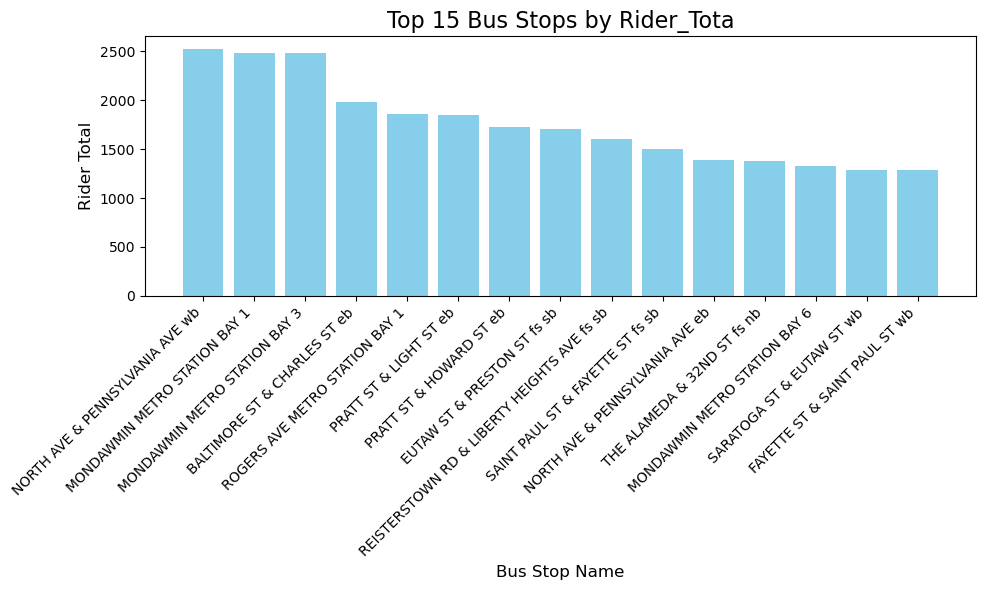

In [64]:
import matplotlib.pyplot as plt

top_15_riders = Bus_Stops[['stop_name', 'Rider_Tota']].sort_values(by='Rider_Tota', ascending=False).head(15)

plt.figure(figsize=(10, 6))
plt.bar(top_15_riders['stop_name'], top_15_riders['Rider_Tota'], color='skyblue')

plt.title('Top 15 Bus Stops by Rider_Tota', fontsize=16)
plt.xlabel('Bus Stop Name', fontsize=12)
plt.ylabel('Rider Total', fontsize=12)
plt.xticks(rotation=45, ha='right') 

plt.tight_layout()  
plt.show()

In [ ]:
plt.figure(figsize=(100,100))

print("Drawing nodes")
nx.draw_networkx_nodes(G,pos,node_size=1,node_color='blue',alpha=0.3)

print("Drawing edges")
nx.draw_networkx_edges(G,pos,edge_color='gray',width=3,style='dashed')

print("Drawing Bus_Stops")

top_riders = Bus_Stops[['X', 'Y','stop_name', 'Rider_Tota']].sort_values(by='Rider_Tota', ascending=False).head(100)

plt.title('Bus Traffic Flow Map', fontsize=16)

plt.scatter(Bus_Stops['X'], Bus_Stops['Y'], color='#555555',s = Bus_Stops['Rider_Tota'])

plt.scatter(top_riders['X'], top_riders['Y'], color='red',s = top_riders['Rider_Tota'])

plt.axis('off')
plt.tight_layout()
plt.show()


Drawing nodes
Drawing edges
Drawing Bus_Stops


# 热力图

In [97]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [19]:
import folium
from folium.plugins import HeatMap

map_center = [39.2992, -76.6094]  
m = folium.Map(location=map_center, zoom_start=12)

heat_data = [[row['Y'], row['X'], row['Rider_Tota']] for index, row in Bus_Stops.iterrows()]

HeatMap(heat_data).add_to(m)

m.save('baltimore_bus_stop_heatmap.html')


In [20]:
import seaborn as sns
import geopandas as gpd
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity
from shapely.geometry import Point

coordinates = Bus_Stops[['X', 'Y']].values

# 设置KDE带宽
bandwidth = 0.01

# 归一化上下车人数
weights = Bus_Stops['Rider_Tota']
weights = (weights - weights.min()) / (weights.max() - weights.min())

# 创建KDE模型并拟合数据
kde = KernelDensity(kernel='gaussian', bandwidth=bandwidth)
kde.fit(coordinates, sample_weight=weights)

# 生成网格数据，用于绘制热力图
x_grid = np.linspace(min(Bus_Stops['X']), max(Bus_Stops['X']), 100)
y_grid = np.linspace(min(Bus_Stops['Y']), max(Bus_Stops['Y']), 100)
xv, yv = np.meshgrid(x_grid, y_grid)
grid_points = np.vstack([xv.ravel(), yv.ravel()]).T

# 计算每个网格点的密度
log_densities = kde.score_samples(grid_points)
densities = np.exp(log_densities).reshape(xv.shape)



c:\Users\simba\anaconda3\Lib\site-packages\sklearn\neighbors\_kde.py:271: RuntimeWarning: divide by zero encountered in log
  log_density = self.tree_.kernel_density(


In [22]:
# 设施名称和坐标
facilities = [
    {"name": "Inner Harbor", "x": 39.2847, "y": -76.6122, "category": "Tourist"},
    {"name": "Penn Station", "x": 39.3083, "y": -76.6167, "category": "Transport"},
    {"name": "Port of Baltimore", "x": 39.2904, "y": -76.6122, "category": "Transport"},
    {"name": "Maryland Science Center", "x": 39.2884, "y": -76.6120, "category": "Museum"},
    {"name": "Maryland Zoo", "x": 39.3200, "y": -76.6500, "category": "Zoo"},
    {"name": "Baltimore Museum of Art", "x": 39.3295, "y": -76.6210, "category": "Museum"},
    {"name": "Johns Hopkins Hospital", "x": 39.2966, "y": -76.5947, "category": "Hospital"},
    {"name": "University of Baltimore", "x": 39.3073, "y": -76.6204, "category": "University"},
    {"name": "Baltimore Mall", "x": 39.3054, "y": -76.6200, "category": "Mall"}
] 

# 定义不同类别的颜色
category_colors = {
    "Tourist": "lime",        # 旅游类
    "Transport": "magenta",   # 交通类
    "Museum": "cyan",         # 博物馆类
    "Zoo": "black",             # 动物园类
    "Hospital": "purple",     # 医院类
    "University": "darkorange", # 大学类
    "Mall": "deepskyblue"     # 商场类
}

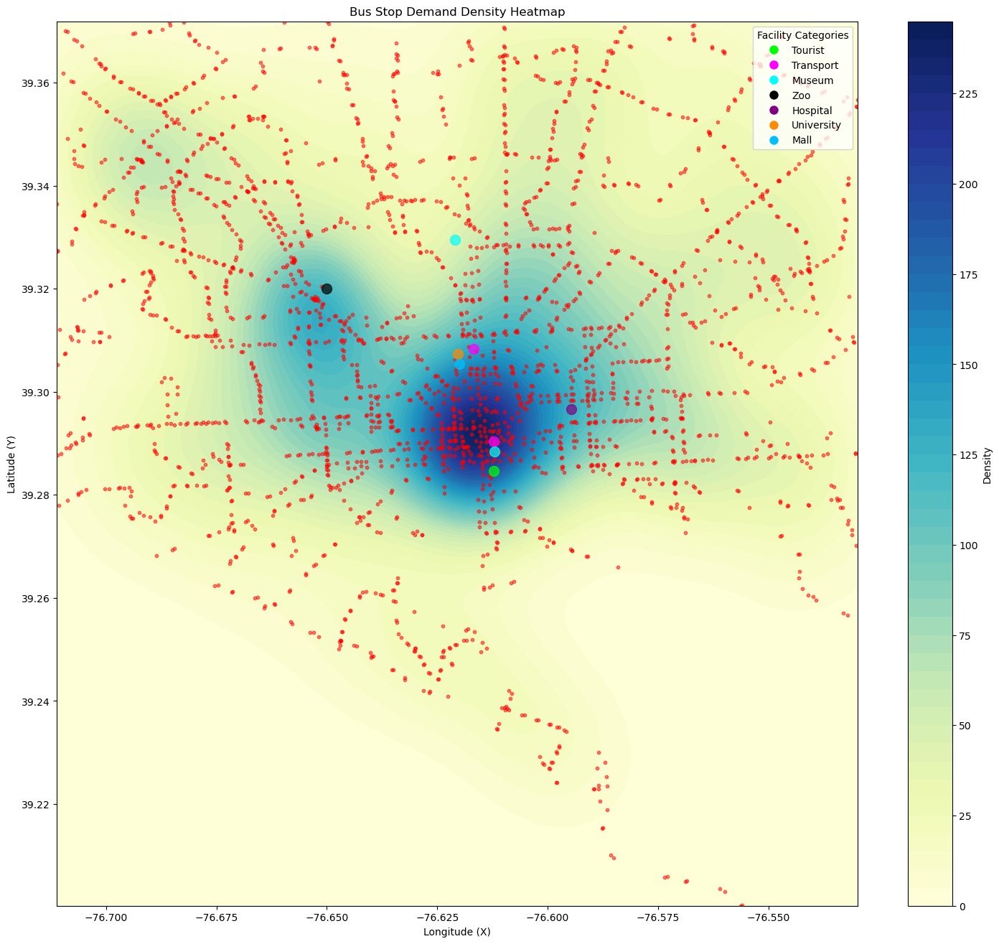

In [23]:
from matplotlib.lines import Line2D
# 绘制热力图
plt.figure(figsize=(18, 16))
plt.contourf(xv, yv, densities, cmap='YlGnBu', levels=50)
plt.colorbar(label='Density')
plt.scatter(Bus_Stops['X'], Bus_Stops['Y'], color='red', s=10, alpha=0.5, label='Bus Stops')

# 添加设施点
for facility in facilities:
    color = category_colors.get(facility["category"], "black")  # 获取颜色
    plt.scatter(facility["y"], facility["x"], color=color, s=100, alpha=0.7)  # 绘制设施点

legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=category) 
                   for category, color in category_colors.items()]
plt.legend(handles=legend_elements, title="Facility Categories", loc='upper right')

plt.title('Bus Stop Demand Density Heatmap')
plt.xlabel('Longitude (X)')
plt.ylabel('Latitude (Y)')
plt.show()

In [72]:
print(f"Min density: {densities.min()}")
print(f"Max density: {densities.max()}")

Min density: 1.4757123488473493e-11
Max density: 240.88483539864177


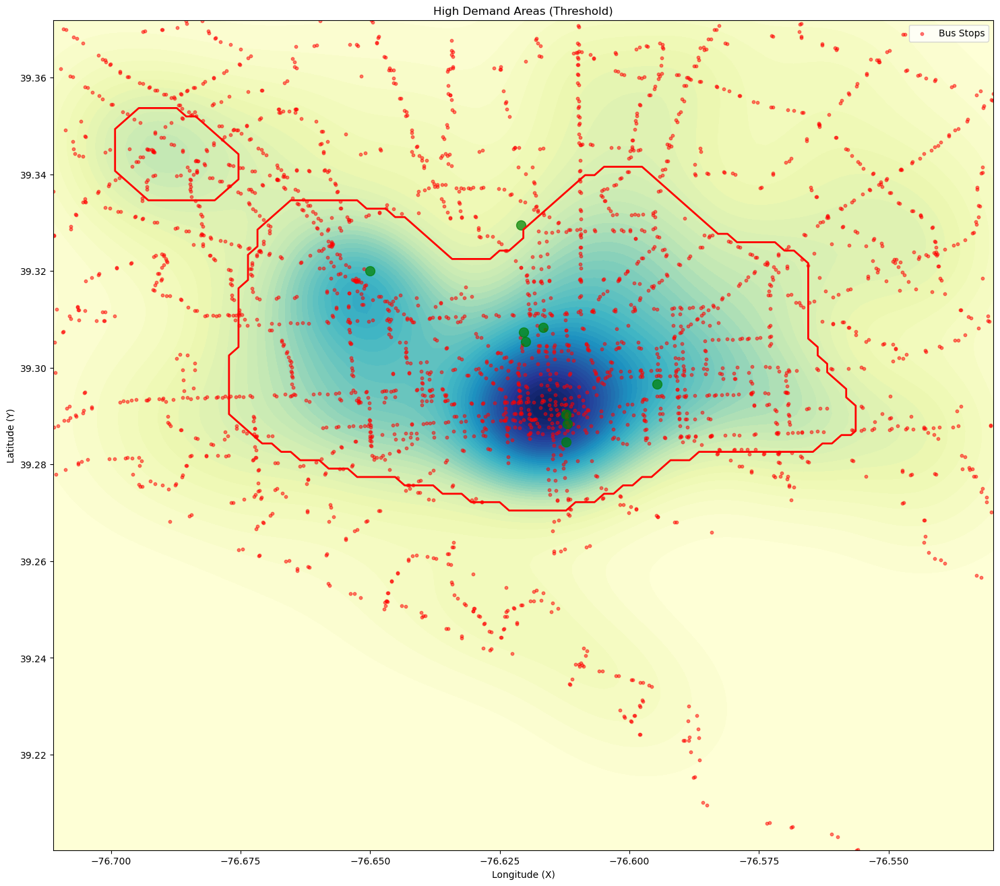

In [24]:
# 根据需求设置一个密度阈值
threshold = densities.max() * 0.2 
high_density_area = densities > threshold

# 绘制高需求区域
plt.figure(figsize=(18, 16))
plt.contourf(xv, yv, densities, cmap='YlGnBu', levels=50)
plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)
plt.scatter(Bus_Stops['X'], Bus_Stops['Y'], color='red', s=10, alpha=0.5, label='Bus Stops')

# 添加绿色设施点
for facility in facilities:
    plt.scatter(facility["y"], facility["x"], color='green', s=100, alpha=0.7)

plt.title('High Demand Areas (Threshold)')
plt.xlabel('Longitude (X)')
plt.ylabel('Latitude (Y)')
plt.legend()
plt.show()

C:\Users\simba\AppData\Local\Temp\ipykernel_14420\1351495047.py:12: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for collection in contours.collections:


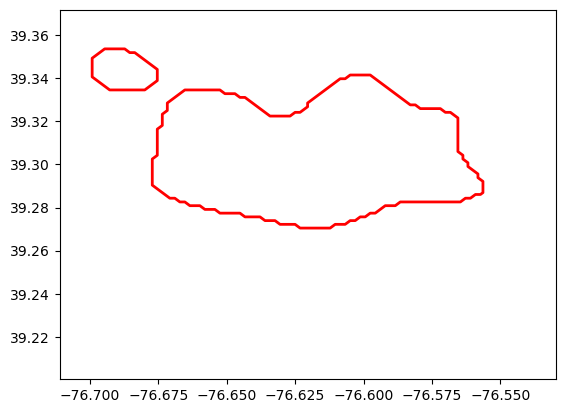

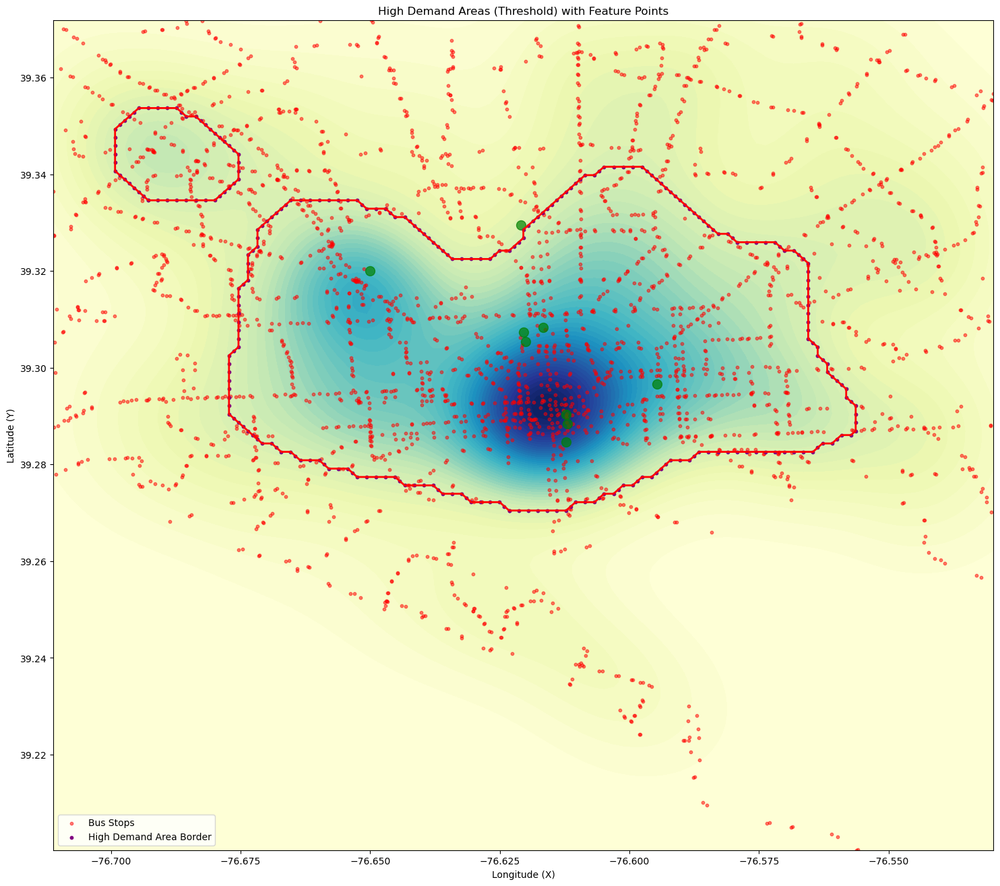

In [132]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point
import geopandas as gpd

# 获取高需求区域的轮廓线
contours = plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)

# 从轮廓线中提取特征点
contour_points = []
for collection in contours.collections:
    for path in collection.get_paths():
        for point in path.vertices:
            contour_points.append(tuple(point))

# 将提取的点存储为CSV格式
contour_points = np.array(contour_points)

# 转换为 DataFrame，并存储为 CSV 文件
df_contour_points = pd.DataFrame(contour_points, columns=["Longitude", "Latitude"])
df_contour_points.to_csv("high_demand_area.csv", index=False)

# 可视化高需求区域与提取的特征点
plt.figure(figsize=(18, 16))
plt.contourf(xv, yv, densities, cmap='YlGnBu', levels=50)
plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)
plt.scatter(Bus_Stops['X'], Bus_Stops['Y'], color='red', s=10, alpha=0.5, label='Bus Stops')

# 添加绿色设施点
for facility in facilities:
    plt.scatter(facility["y"], facility["x"], color='green', s=100, alpha=0.7)

# 添加高需求区域的边界点
plt.scatter(contour_points[:, 0], contour_points[:, 1], color='purple', s=10, label="High Demand Area Border")

plt.title('High Demand Areas (Threshold) with Feature Points')
plt.xlabel('Longitude (X)')
plt.ylabel('Latitude (Y)')
plt.legend()
plt.show()


In [100]:
pip install geopy

  Using cached geopy-2.4.1-py3-none-any.whl.metadata (6.8 kB)
  Using cached geographiclib-2.0-py3-none-any.whl.metadata (1.4 kB)
Using cached geopy-2.4.1-py3-none-any.whl (125 kB)
Using cached geographiclib-2.0-py3-none-any.whl (40 kB)
Note: you may need to restart the kernel to use updated packages.


# 高需求区域评分

C:\Users\simba\AppData\Local\Temp\ipykernel_6368\434771095.py:14: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for collection in contours.collections:


交通均匀分布的评分：0.9567
为 1 的点数：9567/10000
为 0 的点数：433/10000


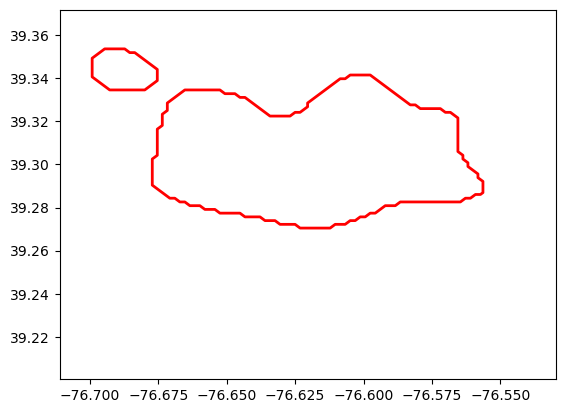

In [28]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon
import random

# 获取高需求区域的轮廓线
contours = plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)

service_radius = 500 #单位：米

# 从轮廓线中提取特征点
contour_points = []
for collection in contours.collections:
    for path in collection.get_paths():
        for point in path.vertices:
            contour_points.append(tuple(point))

# 将提取的点存储为多边形对象
contour_points = np.array(contour_points)
polygon = Polygon(contour_points)

# 生成在多边形内的随机点
def generate_random_points_in_polygon(polygon, N):
    points = []
    while len(points) < N:
        minx, miny, maxx, maxy = polygon.bounds
        random_point = Point(random.uniform(minx, maxx), random.uniform(miny, maxy))
        if polygon.contains(random_point):
            points.append(random_point)
    return points

# 判断站点是否在 500 米圆内
def is_covered_by_bus_station(random_point, bus_stops, radius=500):
    circle = random_point.buffer(radius / 111000)  # 转换半径为度
    for stop in bus_stops.itertuples():
        stop_location = Point(stop.X, stop.Y)  # 站点坐标
        if circle.contains(stop_location):
            return 1  
    return 0  

# 生成 10000 个随机点
random_points = generate_random_points_in_polygon(polygon, 10000)

covered_count = 0
total_count = len(random_points)

# 遍历所有随机点，计算其覆盖情况
for point in random_points:
    covered_count += is_covered_by_bus_station(point, Bus_Stops)

# 计算交通均匀分布的评分（为 1 的比例）
uniform_distribution = covered_count / total_count
print(f"交通均匀分布的评分：{uniform_distribution:.4f}")

# 输出为 1 和为 0 的点数
print(f"为 1 的点数：{covered_count}/10000")
print(f"为 0 的点数：{total_count - covered_count}/10000")

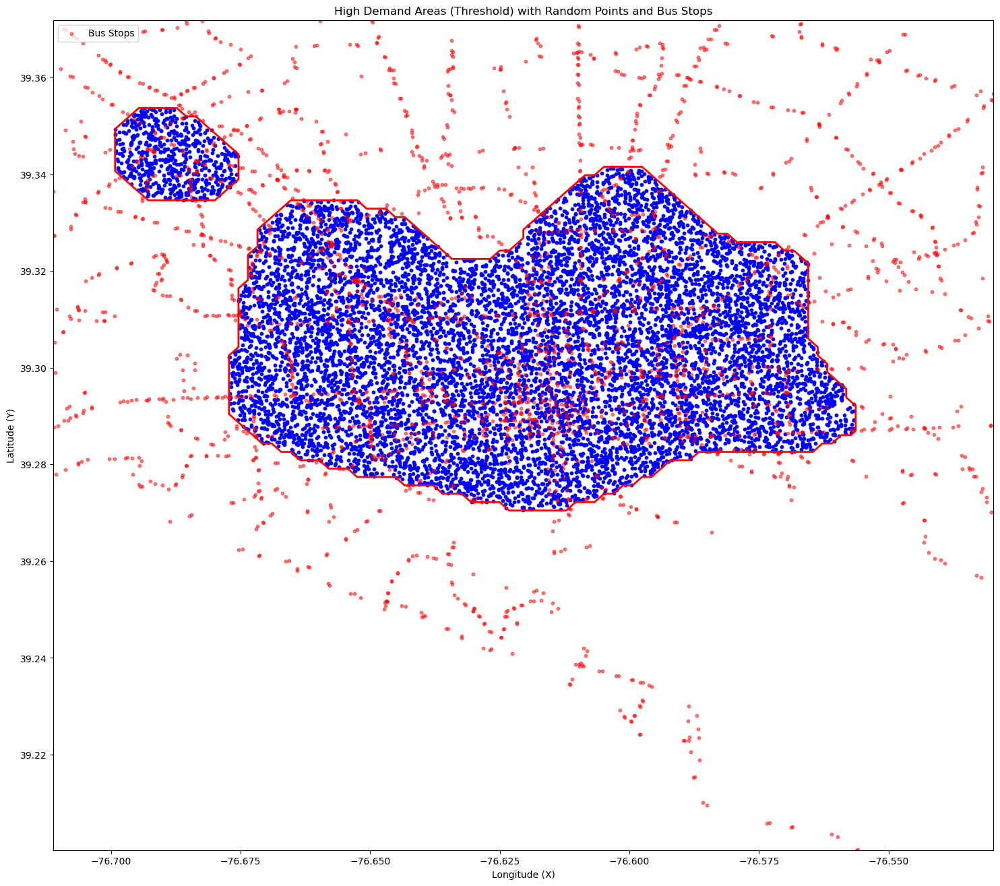

In [137]:
# 可视化高需求区域与生成的随机点
plt.figure(figsize=(18, 16))

# 绘制高需求区域的轮廓线（红色）
plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)

# 绘制生成的随机点（蓝色）
for point in random_points:
    plt.scatter(point.x, point.y, color='blue', s=10)

# 绘制巴士站点
plt.scatter(Bus_Stops['X'], Bus_Stops['Y'], color='red', s=10, alpha=0.5, label='Bus Stops')

# 设置图表标题和标签
plt.title('High Demand Areas (Threshold) with Random Points and Bus Stops')
plt.xlabel('Longitude (X)')
plt.ylabel('Latitude (Y)')

# 显示图例
plt.legend(loc='upper left')
plt.show()

# 非高需求区域评分

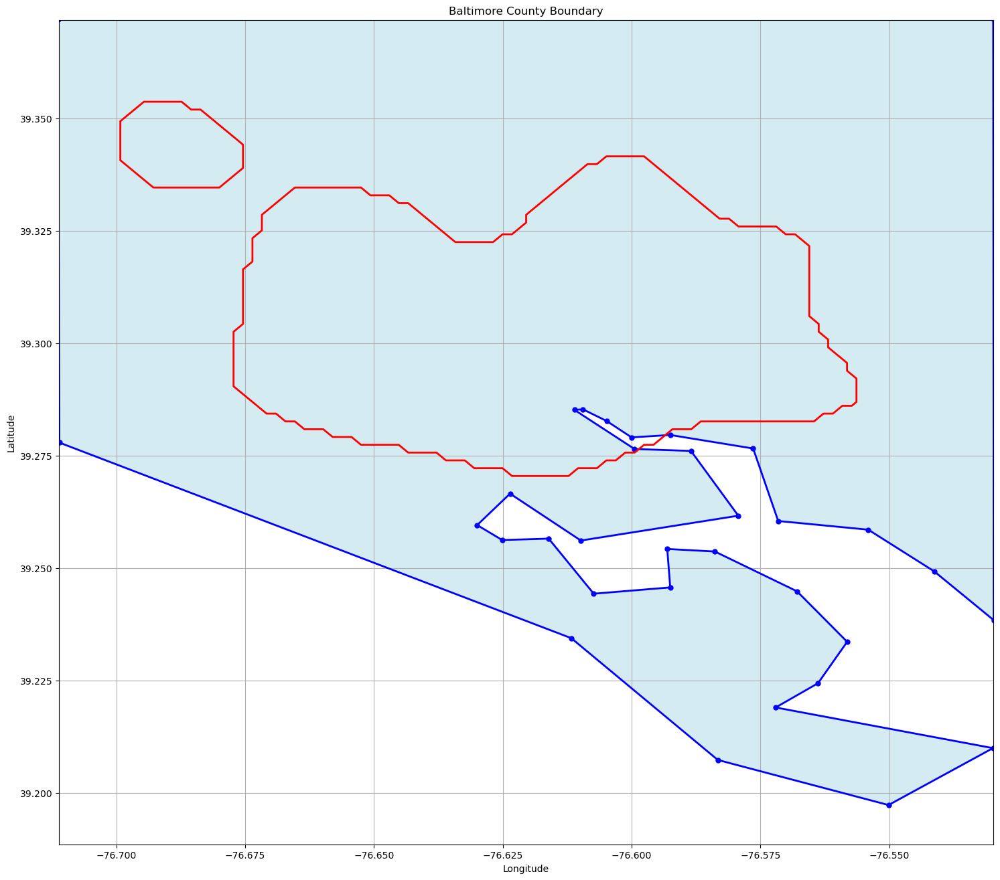

In [66]:
import matplotlib.pyplot as plt

# 提供的坐标数据，按顺序排列
coordinates = [
    (39.371941, -76.711313), (39.277884, -76.711057),
    (39.234407, -76.611701), (39.207324, -76.583256),
    (39.197303, -76.550125), (39.209958, -76.529853),
    (39.218993, -76.572033), (39.224373, -76.563826),
    (39.233600, -76.558150), (39.244831, -76.567897),
    (39.253668, -76.583824), (39.254243, -76.593078),
    (39.245688, -76.592496), (39.244291, -76.607345),
    (39.256542, -76.616088), (39.256219, -76.625109),
    (39.259550, -76.629966), (39.266534, -76.623582),
    (39.256112, -76.609843), (39.261634, -76.579283),
    (39.276037, -76.588472), (39.276466, -76.599435),
    (39.285167, -76.611093), (39.285275, -76.609427),
    (39.282697, -76.604848), (39.279045, -76.599991),
    (39.279582, -76.592497), (39.276574, -76.576399),
    (39.260458, -76.571542), (39.258524, -76.554056),
    (39.249282, -76.541289), (39.238408, -76.529708),
    (39.372091, -76.529813)  # 最后一个坐标
]

# 拆分坐标为纬度和经度
lats, lons = zip(*coordinates)

# 绘制边界框架
plt.figure(figsize=(18, 16))
plt.plot(lons, lats, marker='o', color='b', linestyle='-', linewidth=2, markersize=5)
plt.fill(lons + (lons[0],), lats + (lats[0],), color='lightblue', alpha=0.5)  # 填充颜色
# 绘制高需求区域的轮廓线（红色）
plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)

plt.title("Baltimore County Boundary")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True)
plt.show()


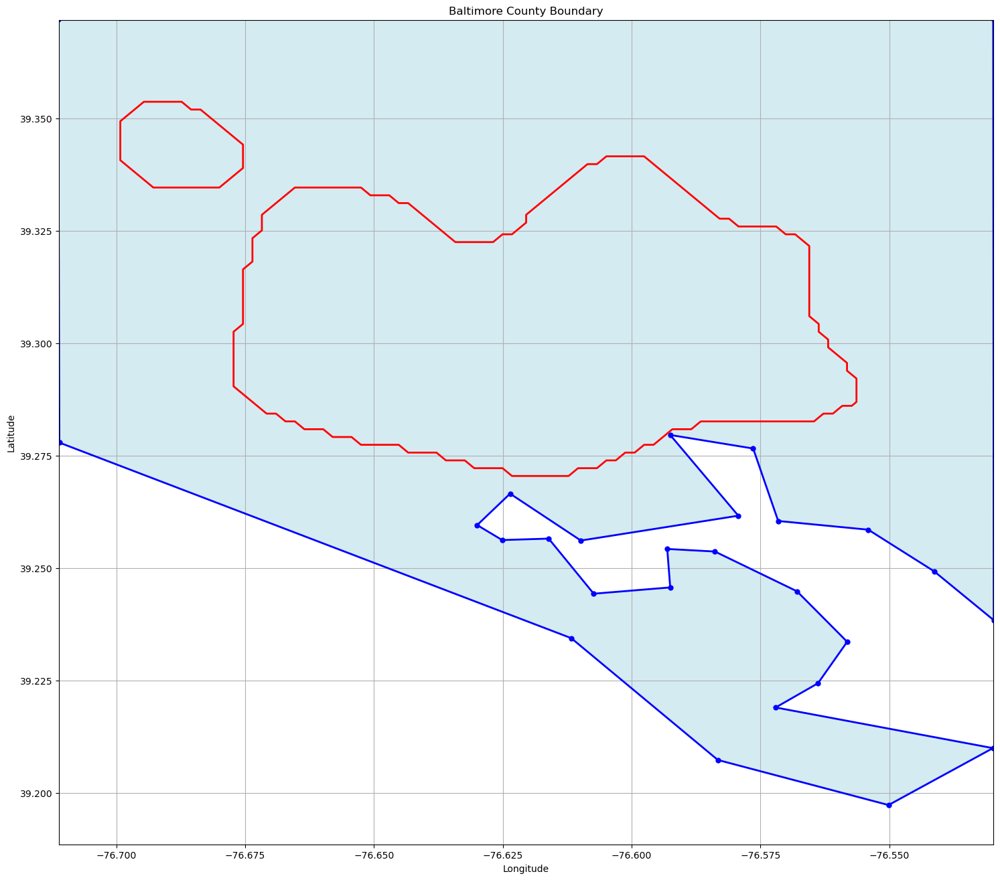

In [50]:
import matplotlib.pyplot as plt

# 提供的坐标数据，按顺序排列
coordinates = [
    (39.371941, -76.711313), (39.277884, -76.711057),
    (39.234407, -76.611701), (39.207324, -76.583256),
    (39.197303, -76.550125), (39.209958, -76.529853),
    (39.218993, -76.572033), (39.224373, -76.563826),
    (39.233600, -76.558150), (39.244831, -76.567897),
    (39.253668, -76.583824), (39.254243, -76.593078),
    (39.245688, -76.592496), (39.244291, -76.607345),
    (39.256542, -76.616088), (39.256219, -76.625109),
    (39.259550, -76.629966), (39.266534, -76.623582),
    (39.256112, -76.609843), (39.261634, -76.579283),

    (39.279582, -76.592497), (39.276574, -76.576399),
    (39.260458, -76.571542), (39.258524, -76.554056),
    (39.249282, -76.541289), (39.238408, -76.529708),
    (39.372091, -76.529813)  # 最后一个坐标
]

# 拆分坐标为纬度和经度
lats, lons = zip(*coordinates)

# 绘制边界框架
plt.figure(figsize=(18, 16))
plt.plot(lons, lats, marker='o', color='b', linestyle='-', linewidth=2, markersize=5)
plt.fill(lons + (lons[0],), lats + (lats[0],), color='lightblue', alpha=0.5)  # 填充颜色
# 绘制高需求区域的轮廓线（红色）
plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)

plt.title("Baltimore County Boundary")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True)
plt.show()


C:\Users\simba\AppData\Local\Temp\ipykernel_6368\374747320.py:31: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for collection in contours.collections:


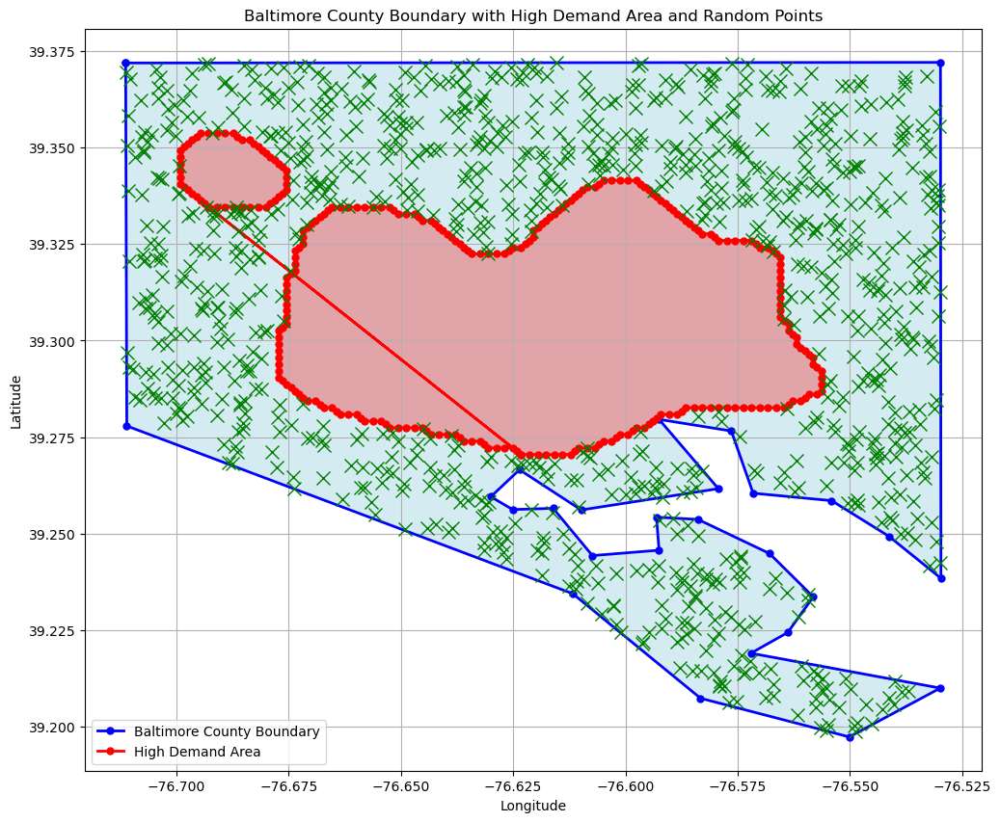

In [55]:
import numpy as np
import random
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon

# 蓝色区域的坐标（由你提供的坐标数据组成）
coordinates = [
    (39.371941, -76.711313), (39.277884, -76.711057),
    (39.234407, -76.611701), (39.207324, -76.583256),
    (39.197303, -76.550125), (39.209958, -76.529853),
    (39.218993, -76.572033), (39.224373, -76.563826),
    (39.233600, -76.558150), (39.244831, -76.567897),
    (39.253668, -76.583824), (39.254243, -76.593078),
    (39.245688, -76.592496), (39.244291, -76.607345),
    (39.256542, -76.616088), (39.256219, -76.625109),
    (39.259550, -76.629966), (39.266534, -76.623582),
    (39.256112, -76.609843), (39.261634, -76.579283),
    (39.279582, -76.592497), (39.276574, -76.576399),
    (39.260458, -76.571542), (39.258524, -76.554056),
    (39.249282, -76.541289), (39.238408, -76.529708),
    (39.372091, -76.529813)  # 最后一个坐标
]

# 将外部边界坐标转换为多边形对象
lats, lons = zip(*coordinates)
polygon_blue = Polygon(zip(lons, lats))

# 通过轮廓线提取红色区域
# 假设 contours 是已经提取出来的轮廓线
contour_points = []
for collection in contours.collections:
    for path in collection.get_paths():
        for point in path.vertices:
            contour_points.append(tuple(point))

# 将提取的点存储为多边形对象
contour_points = np.array(contour_points)
polygon_red = Polygon(contour_points)

# 生成在蓝色边界内且红色边界外的随机点
def generate_random_points(polygon_blue, polygon_red, num_points=5):
    points = []
    while len(points) < num_points:
        minx, miny, maxx, maxy = polygon_blue.bounds
        random_point = Point(random.uniform(minx, maxx), random.uniform(miny, maxy))
        if polygon_blue.contains(random_point) and not polygon_red.contains(random_point):
            points.append(random_point)
    return points

# 生成 5 个随机点
random_points = generate_random_points(polygon_blue, polygon_red, 1000)

# 绘制外部边界和高需求区域边界
plt.figure(figsize=(12, 10))
plt.plot(lons + (lons[0],), lats + (lats[0],), marker='o', color='blue', linestyle='-', linewidth=2, markersize=5, label="Baltimore County Boundary")
plt.fill(lons + (lons[0],), lats + (lats[0],), color='lightblue', alpha=0.5)

# 绘制红色区域边界（高需求区域）
red_lons, red_lats = zip(*contour_points)
plt.plot(red_lons + (red_lons[0],), red_lats + (red_lats[0],), marker='o', color='red', linestyle='-', linewidth=2, markersize=5, label="High Demand Area")
plt.fill(red_lons + (red_lons[0],), red_lats + (red_lats[0],), color='red', alpha=0.3)

# 绘制生成的随机点（绿色）
for point in random_points:
    plt.plot(point.x, point.y, marker='x', color='green', markersize=10)

# 添加标题和图例
plt.title("Baltimore County Boundary with High Demand Area and Random Points")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend()

# 显示图形
plt.grid(True)
plt.show()


In [57]:
import numpy as np
import random
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon
import geopy.distance  # 用于计算经纬度之间的距离

# 蓝色区域的坐标（由你提供的坐标数据组成）
coordinates = [
    (39.371941, -76.711313), (39.277884, -76.711057),
    (39.234407, -76.611701), (39.207324, -76.583256),
    (39.197303, -76.550125), (39.209958, -76.529853),
    (39.218993, -76.572033), (39.224373, -76.563826),
    (39.233600, -76.558150), (39.244831, -76.567897),
    (39.253668, -76.583824), (39.254243, -76.593078),
    (39.245688, -76.592496), (39.244291, -76.607345),
    (39.256542, -76.616088), (39.256219, -76.625109),
    (39.259550, -76.629966), (39.266534, -76.623582),
    (39.256112, -76.609843), (39.261634, -76.579283),
    (39.279582, -76.592497), (39.276574, -76.576399),
    (39.260458, -76.571542), (39.258524, -76.554056),
    (39.249282, -76.541289), (39.238408, -76.529708),
    (39.372091, -76.529813)  # 最后一个坐标
]

# 将外部边界坐标转换为多边形对象
lats, lons = zip(*coordinates)
polygon_blue = Polygon(zip(lons, lats))

# 通过轮廓线提取红色区域
contour_points = []
for collection in contours.collections:
    for path in collection.get_paths():
        for point in path.vertices:
            contour_points.append(tuple(point))

# 将提取的点存储为多边形对象
contour_points = np.array(contour_points)
polygon_red = Polygon(contour_points)

# 生成在蓝色边界内且红色边界外的均匀分布的随机点
def generate_random_points(polygon_blue, polygon_red, num_points=1000):
    points = []
    while len(points) < num_points:
        minx, miny, maxx, maxy = polygon_blue.bounds
        random_point = Point(random.uniform(minx, maxx), random.uniform(miny, maxy))
        if polygon_blue.contains(random_point) and not polygon_red.contains(random_point):
            points.append(random_point)
    return points

# 生成 1000 个随机点
random_points = generate_random_points(polygon_blue, polygon_red, 10000)

# 判断站点是否在 500 米圆内
def is_covered_by_bus_station(random_point, bus_stops, radius=500):
    circle = random_point.buffer(radius / 111000)  # 转换半径为度
    for stop in bus_stops.itertuples():
        stop_location = Point(stop.X, stop.Y)  # 站点坐标
        if circle.contains(stop_location):
            return 1  # 站点在 500 米范围内
    return 0  # 站点不在 500 米范围内

# 计算交通均匀分布评分
covered_count = 0
total_count = len(random_points)

for point in random_points:
    covered_count += is_covered_by_bus_station(point, Bus_Stops)  # 你需要提供 Bus_Stops 数据

# 计算交通均匀分布的评分（为 1 的比例）
uniform_distribution = covered_count / total_count
print(f"交通均匀分布的评分：{uniform_distribution:.4f}")

# 输出为 1 和为 0 的点数
print(f"为 1 的点数：{covered_count}/{total_count}")
print(f"为 0 的点数：{total_count - covered_count}/{total_count}")


C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1727259683.py:31: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.
  for collection in contours.collections:


交通均匀分布的评分：0.7684
为 1 的点数：7684/10000
为 0 的点数：2316/10000


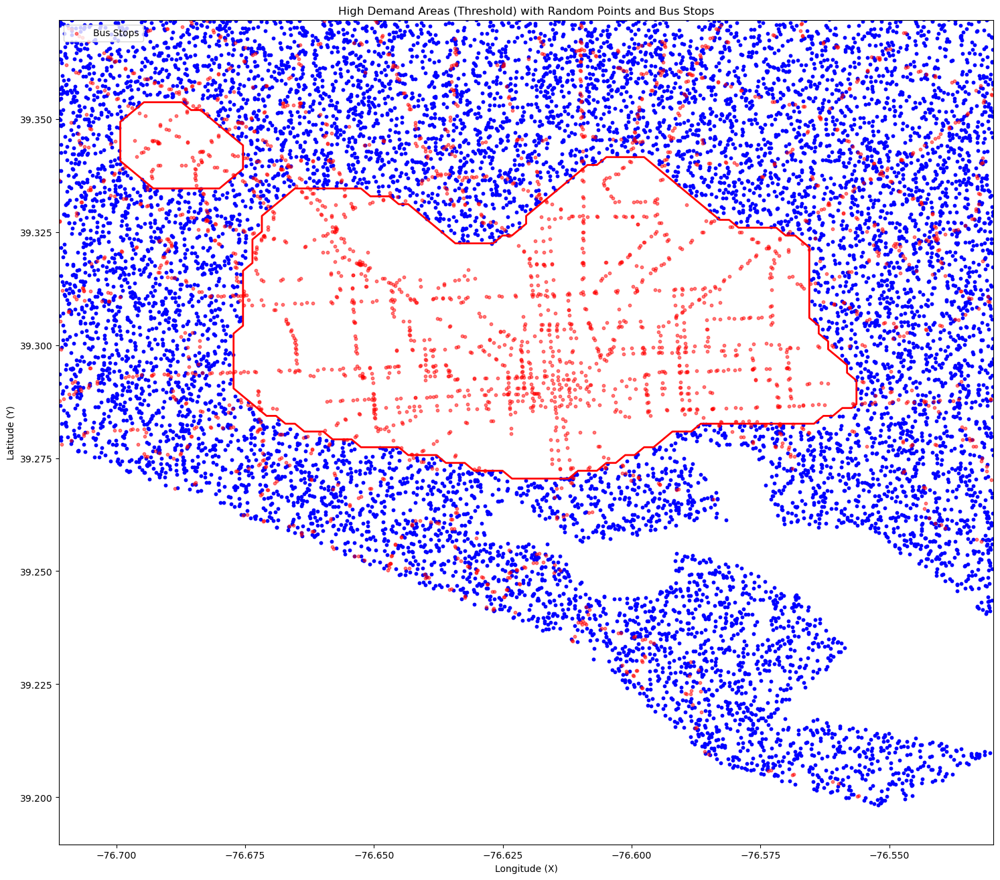

In [58]:
import matplotlib.pyplot as plt

# 可视化高需求区域与生成的随机点
plt.figure(figsize=(18, 16))

# 绘制高需求区域的轮廓线（红色）
plt.contour(xv, yv, high_density_area, levels=[0.5], colors='red', linewidths=2)

# 绘制生成的随机点（蓝色）
for point in random_points:
    plt.scatter(point.x, point.y, color='blue', s=10)

# 绘制巴士站点（假设 Bus_Stops 数据已经加载，包含 X 和 Y 列）
plt.scatter(Bus_Stops['X'], Bus_Stops['Y'], color='red', s=10, alpha=0.5, label='Bus Stops')

# 设置图表标题和标签
plt.title('High Demand Areas (Threshold) with Random Points and Bus Stops')
plt.xlabel('Longitude (X)')
plt.ylabel('Latitude (Y)')

# 显示图例
plt.legend(loc='upper left')
plt.show()


# 线路聚类,找线路


In [153]:
Bus_Stops_row = pd.read_csv('data\Bus_Stops.csv')

<>:1: SyntaxWarning: invalid escape sequence '\B'
<>:1: SyntaxWarning: invalid escape sequence '\B'
C:\Users\simba\AppData\Local\Temp\ipykernel_14420\2327549531.py:1: SyntaxWarning: invalid escape sequence '\B'
  Bus_Stops_row = pd.read_csv('data\Bus_Stops.csv')


In [167]:
print(Bus_Stops_row.head())

           Y          X                            stop_name  Rider_On  \
0  39.350945 -76.660393  CYLBURN AVE & GREENSPRING AVE fs wb       201   
1  39.351545 -76.663359       LANIER AVE & SINAI HOSPITAL sb        38   
2  39.352749 -76.664492        LANIER AVE & BELVEDERE AVE nb       147   
3  39.346756 -76.658233     YELLOWOOD AVE & FLAX TERR OPP sb        51   
4  39.348262 -76.654797      TAMARIND RD & SPRINGARDEN DR nb        19   

   Rider_Off  Rider_Tota  Stop_Rider   Routes_Ser  \
0        167         368         250  94,31,31,91   
1         24          62        1727     94,31,91   
2         45         192         594     94,31,91   
3         61         113        1068        91,91   
4         23          43        2161        91,91   

                               Distributi Mode Shelter          County  \
0  E1 - Public Domain - Internal Use Only  Bus     Yes  Baltimore City   
1  E1 - Public Domain - Internal Use Only  Bus      No  Baltimore City   
2  E1 - Public

In [169]:
import pandas as pd

# Read the dataset
Bus_Stops_row = pd.read_csv('data/Bus_Stops.csv')

# Split 'Routes_Ser' into separate values and remove any leading/trailing spaces
Bus_Stops_row['Routes_Ser'] = Bus_Stops_row['Routes_Ser'].str.split(',')

# Create an empty dictionary to store the bus stop lists for each route
bus_route_dict = {}

# Iterate over each row in the DataFrame
for _, row in Bus_Stops_row.iterrows():
    routes = row['Routes_Ser']
    stop_name = row['stop_name']
    
    # Add stop_name to the corresponding route(s) in the dictionary
    for route in routes:
        route = route.strip()  # Remove any leading/trailing spaces
        if route not in bus_route_dict:
            bus_route_dict[route] = []
        bus_route_dict[route].append(stop_name)

# Output all bus routes and their stops
for route, stops in bus_route_dict.items():
    print(f"Bus Route {route}:")
    print(stops)
    print("\n")


Bus Route 94:
['CYLBURN AVE & GREENSPRING AVE fs wb', 'LANIER AVE & SINAI HOSPITAL sb', 'LANIER AVE & BELVEDERE AVE nb', 'CHARLES ST & HILL sb', 'HANOVER & HENRIETTA sb', 'HANOVER ST & CROSS ST sb', 'HANOVER & OSTEND  sb', 'HANOVER & CLEMENT sb', 'FORT AVE & CHARLES ST fs eb', 'FORT AVE & LIGHT ST eb', 'FORT AVE & RIVERSIDE AVE eb', 'FORT AVE & JACKSON ST eb', 'FORT AVE & LAWRENCE ST eb', 'FORT AVE & WOODALL ST eb', 'FORT AVE & DECATUR ST eb', 'FORT AVE & DECATUR ST eb', 'FORT AVE & ANDRE ST eb', 'FORT MCHENRY', 'FORT MCHENRY', 'FORT AVE & ANDRE ST wb', 'FORT AVE & DECATUR ST wb', 'FORT AVE & WOODALL ST wb', 'FORT AVE & LAWRENCE ST wb', 'FORT AVE & JACKSON ST wb', 'FORT AVE & RIVERSIDE AVE wb', 'FORT AVE & LIGHT ST wb', 'FORT AVE & CHARLES ST wb', 'CHARLES ST & OSTEND ST nb', 'CHARLES ST & CROSS ST nb', 'CHARLES ST & HENRIETTA ST nb', 'CHARLES ST & LEE ST nb', 'CHARLES ST & CONWAY ST nb', 'FALLS RD & COLD SPRING LN sb', 'FALLS RD & ROLAND HEIGHTS AVE sb', 'FALLS RD & 41ST ST sb', 'CHAR

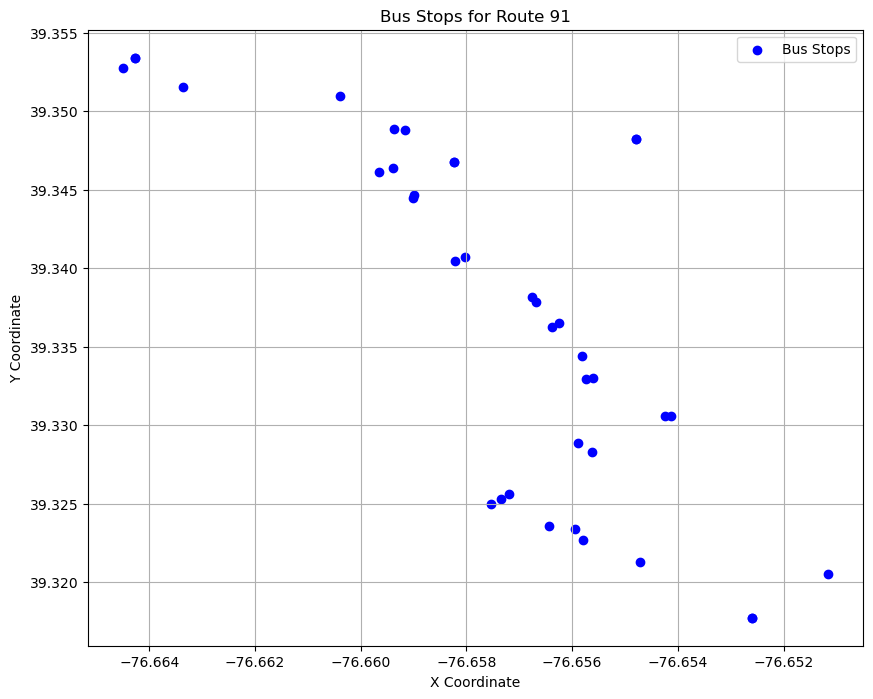

In [173]:
import pandas as pd
import matplotlib.pyplot as plt

# Read the dataset
Bus_Stops_row = pd.read_csv('data/Bus_Stops.csv')

# Split 'Routes_Ser' into separate values and remove any leading/trailing spaces
Bus_Stops_row['Routes_Ser'] = Bus_Stops_row['Routes_Ser'].str.split(',')

# Create the bus_route_dict as before
bus_route_dict = {}
for _, row in Bus_Stops_row.iterrows():
    routes = row['Routes_Ser']
    stop_name = row['stop_name']
    x = row['X']
    y = row['Y']
    
    for route in routes:
        route = route.strip()  # Remove any leading/trailing spaces
        if route not in bus_route_dict:
            bus_route_dict[route] = []
        bus_route_dict[route].append({'stop_name': stop_name, 'X': x, 'Y': y})

# Get the bus stops for route 91
bus_91 = bus_route_dict.get('91', [])

# Extract X, Y coordinates for bus_91
x_coords = [stop['X'] for stop in bus_91]
y_coords = [stop['Y'] for stop in bus_91]

# Plot the bus stops on a scatter plot
plt.figure(figsize=(10, 8))
plt.scatter(x_coords, y_coords, c='blue', marker='o', label='Bus Stops')
plt.title("Bus Stops for Route 91")
plt.xlabel("X Coordinate")
plt.ylabel("Y Coordinate")
plt.legend()
plt.grid(True)

# Show the plot
plt.show()


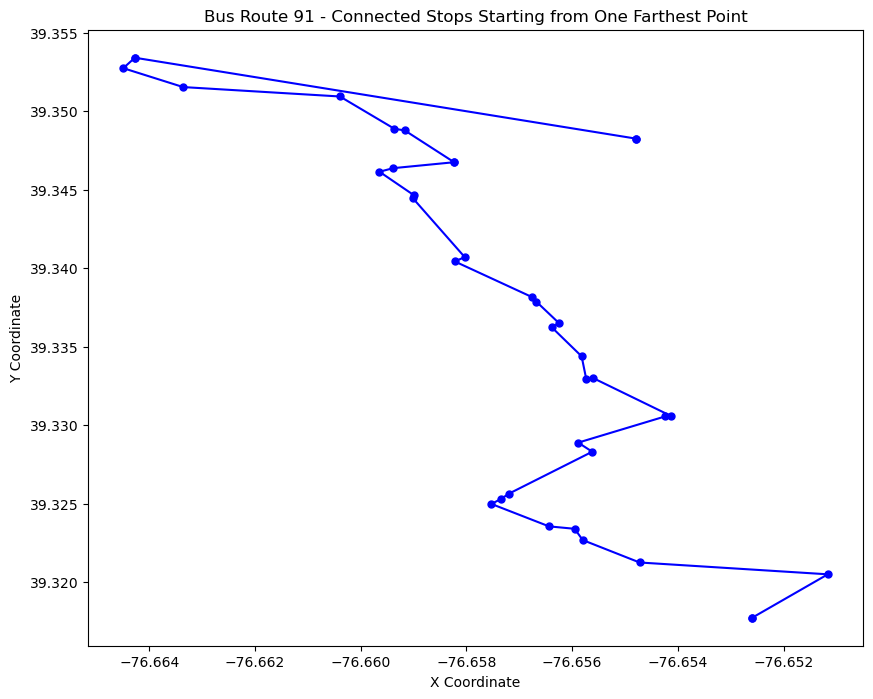

In [179]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Read the dataset
Bus_Stops_row = pd.read_csv('data/Bus_Stops.csv')

# Split 'Routes_Ser' into separate values and remove any leading/trailing spaces
Bus_Stops_row['Routes_Ser'] = Bus_Stops_row['Routes_Ser'].str.split(',')

# Create the bus_route_dict as before
bus_route_dict = {}
for _, row in Bus_Stops_row.iterrows():
    routes = row['Routes_Ser']
    stop_name = row['stop_name']
    x = row['X']
    y = row['Y']
    
    for route in routes:
        route = route.strip()  # Remove any leading/trailing spaces
        if route not in bus_route_dict:
            bus_route_dict[route] = []
        bus_route_dict[route].append({'stop_name': stop_name, 'X': x, 'Y': y})

# Get the bus stops for route 91
bus_91 = bus_route_dict.get('91', [])

# Extract X, Y coordinates for bus_91
x_coords = [stop['X'] for stop in bus_91]
y_coords = [stop['Y'] for stop in bus_91]
stop_names = [stop['stop_name'] for stop in bus_91]

# Function to calculate Euclidean distance between two points
def calculate_distance(p1, p2):
    return np.sqrt((p2[0] - p1[0])**2 + (p2[1] - p1[1])**2)

# Find the two farthest points
max_distance = 0
start_point = None
end_point = None
for i in range(len(bus_91)):
    for j in range(i + 1, len(bus_91)):
        dist = calculate_distance((x_coords[i], y_coords[i]), (x_coords[j], y_coords[j]))
        if dist > max_distance:
            max_distance = dist
            start_point = i
            end_point = j

# Choose one of the farthest points as the starting point (let's choose start_point)
route_indices = [start_point]
visited = [start_point]

# Build the path by finding the closest unvisited point
current_point = start_point
while len(visited) < len(bus_91):
    closest_point = None
    min_distance = float('inf')
    
    for i in range(len(bus_91)):
        if i not in visited:
            dist = calculate_distance((x_coords[current_point], y_coords[current_point]), (x_coords[i], y_coords[i]))
            if dist < min_distance:
                min_distance = dist
                closest_point = i
                
    route_indices.append(closest_point)
    visited.append(closest_point)
    current_point = closest_point

# Extract the ordered X, Y coordinates and stop names for the route
ordered_x_coords = [x_coords[i] for i in route_indices]
ordered_y_coords = [y_coords[i] for i in route_indices]
ordered_stop_names = [stop_names[i] for i in route_indices]

# Plot the bus stops with the route lines (excluding connecting start and end points)
plt.figure(figsize=(10, 8))
plt.plot(ordered_x_coords, ordered_y_coords, marker='o', color='blue', linestyle='-', markersize=5)

# Title and labels
plt.title("Bus Route 91 - Connected Stops Starting from One Farthest Point")
plt.xlabel("X Coordinate")
plt.ylabel("Y Coordinate")

# Remove the grid and station names
plt.grid(False)  # Remove the grid

# Show the plot
plt.show()


C:\Users\simba\AppData\Local\Temp\ipykernel_6368\2846537434.py:40: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab20', len(bus_route_dict))  # Get 20 different colors
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


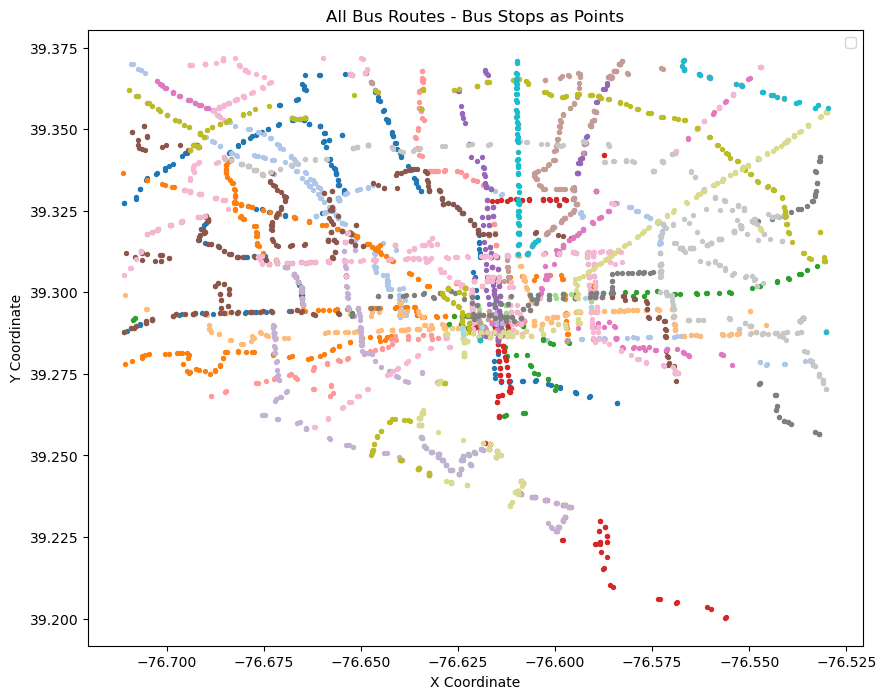

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Read the dataset
Bus_Stops_row = pd.read_csv('data/Bus_Stops.csv')

# Split 'Routes_Ser' into separate values and remove any leading/trailing spaces
Bus_Stops_row['Routes_Ser'] = Bus_Stops_row['Routes_Ser'].str.split(',')

# Create the bus_route_dict as before
bus_route_dict = {}
for _, row in Bus_Stops_row.iterrows():
    routes = row['Routes_Ser']
    stop_name = row['stop_name']
    x = row['X']
    y = row['Y']
    
    for route in routes:
        route = route.strip()  # Remove any leading/trailing spaces
        if route not in bus_route_dict:
            bus_route_dict[route] = []
        bus_route_dict[route].append({'stop_name': stop_name, 'X': x, 'Y': y})

# Function to calculate Euclidean distance between two points
def calculate_distance(p1, p2):
    return np.sqrt((p2[0] - p1[0])**2 + (p2[1] - p1[1])**2)

# Function to generate points for a given bus
def create_route(bus_route):
    bus_route_stops = bus_route_dict.get(bus_route, [])

    # Extract X, Y coordinates for the bus route
    x_coords = [stop['X'] for stop in bus_route_stops]
    y_coords = [stop['Y'] for stop in bus_route_stops]

    return x_coords, y_coords

# Generate unique colors for each bus route (you can choose more or different colors)
colors = plt.cm.get_cmap('tab20', len(bus_route_dict))  # Get 20 different colors

# Plot the bus stops for all routes as points (without connecting them)
plt.figure(figsize=(10, 8))

# Iterate over all the bus routes and plot each one as points
for i, bus_route in enumerate(bus_route_dict.keys()):
    x_coords, y_coords = create_route(bus_route)
    
    # Plot each route's stops as points with a unique color
    plt.scatter(x_coords, y_coords, color=colors(i / len(bus_route_dict)),s=8)

# Title and labels
plt.title("All Bus Routes - Bus Stops as Points")
plt.xlabel("X Coordinate")
plt.ylabel("Y Coordinate")

# Remove the grid
plt.grid(False)  # Remove the grid

# Show the plot
plt.legend()
plt.show()


C:\Users\simba\AppData\Local\Temp\ipykernel_6368\1215022886.py:61: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab20', len(bus_route_dict))  # Get 20 different colors


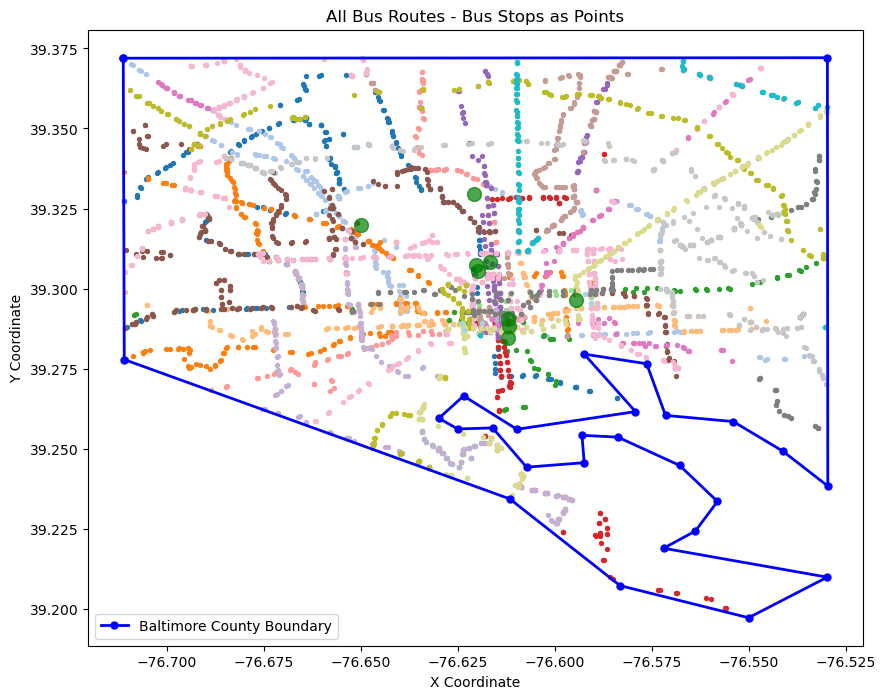

In [69]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Read the dataset
Bus_Stops_row = pd.read_csv('data/Bus_Stops.csv')

# Split 'Routes_Ser' into separate values and remove any leading/trailing spaces
Bus_Stops_row['Routes_Ser'] = Bus_Stops_row['Routes_Ser'].str.split(',')

coordinates = [
    (39.371941, -76.711313), (39.277884, -76.711057),
    (39.234407, -76.611701), (39.207324, -76.583256),
    (39.197303, -76.550125), (39.209958, -76.529853),
    (39.218993, -76.572033), (39.224373, -76.563826),
    (39.233600, -76.558150), (39.244831, -76.567897),
    (39.253668, -76.583824), (39.254243, -76.593078),
    (39.245688, -76.592496), (39.244291, -76.607345),
    (39.256542, -76.616088), (39.256219, -76.625109),
    (39.259550, -76.629966), (39.266534, -76.623582),
    (39.256112, -76.609843), (39.261634, -76.579283),
    (39.279582, -76.592497), (39.276574, -76.576399),
    (39.260458, -76.571542), (39.258524, -76.554056),
    (39.249282, -76.541289), (39.238408, -76.529708),
    (39.372091, -76.529813)  # 最后一个坐标
]

# 将外部边界坐标转换为多边形对象
lats, lons = zip(*coordinates)
polygon_blue = Polygon(zip(lons, lats))

# Create the bus_route_dict as before
bus_route_dict = {}
for _, row in Bus_Stops_row.iterrows():
    routes = row['Routes_Ser']
    stop_name = row['stop_name']
    x = row['X']
    y = row['Y']
    
    for route in routes:
        route = route.strip()  # Remove any leading/trailing spaces
        if route not in bus_route_dict:
            bus_route_dict[route] = []
        bus_route_dict[route].append({'stop_name': stop_name, 'X': x, 'Y': y})

# Function to calculate Euclidean distance between two points
def calculate_distance(p1, p2):
    return np.sqrt((p2[0] - p1[0])**2 + (p2[1] - p1[1])**2)

# Function to generate points for a given bus
def create_route(bus_route):
    bus_route_stops = bus_route_dict.get(bus_route, [])

    # Extract X, Y coordinates for the bus route
    x_coords = [stop['X'] for stop in bus_route_stops]
    y_coords = [stop['Y'] for stop in bus_route_stops]

    return x_coords, y_coords

# Generate unique colors for each bus route (you can choose more or different colors)
colors = plt.cm.get_cmap('tab20', len(bus_route_dict))  # Get 20 different colors

# Plot the bus stops for all routes as points (without connecting them)
plt.figure(figsize=(10, 8))

# Iterate over all the bus routes and plot each one as points
for i, bus_route in enumerate(bus_route_dict.keys()):
    x_coords, y_coords = create_route(bus_route)
    
    # Plot each route's stops as points with a unique color
    plt.scatter(x_coords, y_coords, color=colors(i / len(bus_route_dict)),s=8)

# 添加绿色设施点
for facility in facilities:
    plt.scatter(facility["y"], facility["x"], color='green', s=100, alpha=0.7)

# 绘制外部边界和高需求区域边界
plt.plot(lons + (lons[0],), lats + (lats[0],), marker='o', color='blue', linestyle='-', linewidth=2, markersize=5, label="Baltimore County Boundary")

# Title and labels
plt.title("All Bus Routes - Bus Stops as Points")
plt.xlabel("X Coordinate")
plt.ylabel("Y Coordinate")

# Remove the grid
plt.grid(False)  # Remove the grid

# Show the plot
plt.legend()
plt.show()


In [199]:
import pandas as pd

# Read the dataset
Bus_Stops_row = pd.read_csv('data/Bus_Stops.csv')

# Split 'Routes_Ser' into separate values and remove any leading/trailing spaces
Bus_Stops_row['Routes_Ser'] = Bus_Stops_row['Routes_Ser'].str.split(',')

# Get the unique bus routes and remove any leading/trailing spaces
bus_routes = sorted(set([route.strip() for routes in Bus_Stops_row['Routes_Ser'] for route in routes]))

# Output the available bus numbers in one line, separated by commas
print("Available bus routes:", ", ".join(bus_routes))


Available bus routes: 000, 103, 104, 105, 115, 120, 150, 154, 160, 163, 21, 210, 210; 215, 210; 215; 320; 411; 420; 310, 215, 215; 210, 22, 26, 28, 29, 30, 31, 310, 320, 33, 34, 36, 38, 410, 411, 411; 420, 420, 51, 52, 53, 54, 56, 57, 59, 62, 63, 65, 67, 69, 70, 71, 73, 75, 76, 77, 78, 79, 80, 82, 83, 85, 89, 91, 92, 94, 95, BL, BR, GD, GR, LM, NV, OR, PK, PR, RD, SV, YW


In [70]:
import folium

# This line allows you to input which bus route you want to see in the map
user_input = "SV"  # Change this line with your selected bus route, e.g., "92", "94"

# Function to generate and display the map for the chosen bus route
def display_bus_route_map(route):
    filtered_stops = Bus_Stops_row[Bus_Stops_row['Routes_Ser'].apply(lambda x: route in x)]

    # Create a folium map centered on the first bus stop's coordinates
    map_center = [filtered_stops['Y'].iloc[0], filtered_stops['X'].iloc[0]]
    m = folium.Map(location=map_center, zoom_start=12)

    # Add markers for each stop on the map
    for index, row in filtered_stops.iterrows():
        lat = row['Y']
        lon = row['X']
        stop_name = row['stop_name']
        
        folium.Marker([lat, lon], popup=stop_name).add_to(m)

    # Display the map (for Jupyter, IPython, or save it as HTML)
    return m

# Call the function to display the map for the bus route selected in the previous line
display_bus_route_map(user_input)


# 找空白，加站点

In [189]:
Bus_Stops = pd.read_csv('data\Bus_Stops.csv')

<>:1: SyntaxWarning: invalid escape sequence '\B'
<>:1: SyntaxWarning: invalid escape sequence '\B'
C:\Users\simba\AppData\Local\Temp\ipykernel_14420\2268863767.py:1: SyntaxWarning: invalid escape sequence '\B'
  Bus_Stops = pd.read_csv('data\Bus_Stops.csv')


In [190]:
print(Bus_Stops.columns)

Index(['Y', 'X', 'stop_name', 'Rider_On', 'Rider_Off', 'Rider_Tota',
       'Stop_Rider', 'Routes_Ser', 'Distributi', 'Mode', 'Shelter', 'County',
       'stop_id'],
      dtype='object')
